<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Pre-requisites" data-toc-modified-id="Pre-requisites-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Pre-requisites</a></span></li><li><span><a href="#Instructions" data-toc-modified-id="Instructions-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Instructions</a></span></li><li><span><a href="#Imports-and-Constants" data-toc-modified-id="Imports-and-Constants-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Imports and Constants</a></span></li><li><span><a href="#Validate-and-Split-Exported-TFRecords" data-toc-modified-id="Validate-and-Split-Exported-TFRecords-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Validate and Split Exported TFRecords</a></span></li><li><span><a href="#Calculate-Mean-and-Std-Dev-for-Each-Band" data-toc-modified-id="Calculate-Mean-and-Std-Dev-for-Each-Band-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Calculate Mean and Std-Dev for Each Band</a></span></li></ul></div>

## Pre-requisites

Go through the [`preprocessing/0_export_tfrecords.ipynb`](./0_export_tfrecords.ipynb) notebook.

Before running this notebook, you should have the following structure under the `data/` directory:

```
data/
    dhs_tfrecords_raw/
        angola_2011_00.tfrecord.gz
        ...
        zimbabwe_2015_XX.tfrecord.gz
    dhsnl_tfrecords_raw/
        angola_2010_00.tfrecord.gz
        ...
        zimbabwe_2016_XX.tfrecord.gz
    lsms_tfrecords_raw/
        ethiopia_2011_00.tfrecord.gz
        ...
        uganda_2013_XX.tfrecord.gz
```

## Instructions

This notebook processes the exported TFRecords as follows:
1. Verifies that the fields in the TFRecords match the original CSV files.
2. Splits each monolithic TFRecord file exported from Google Earth Engine into one file per record.

After running this notebook, you should have three new folders (`dhs_tfrecords`, `dhsnl_tfrecords`, and `lsms_tfrecords`) under `data/`:

```
data/
    dhs_tfrecords/
        angola_2011/
            00000.tfrecord.gz
            ...
            00229.tfrecord.gz
        ...
        zimbabwe_2015/
            00000.tfrecord.gz
            ...
            00399.tfrecord.gz
    dhsnl_tfrecords/
        angola_2010/
            00000.tfrecord.gz
            ...
            07734.tfrecord.gz
        zimbabwe_2016/
            00000.tfrecord.gz
            ...
            03584.tfrecord.gz
    lsms_tfrecords/
        ethiopia_2011/
            00000.tfrecord.gz
            ...
            00326.tfrecord.gz
        uganda_2013/
            00000.tfrecord.gz
            ...
            00164.tfrecord.gz
```

This notebook also calculates the mean and standard deviation of each band across each of the 3 datasets.

## Imports and Constants

In [1]:
%load_ext autoreload
%autoreload 2

# change directory to repo root, and verify
%cd ~/africa_poverty_clean
!pwd

/home/jupyter/africa_poverty_clean
/home/jupyter/africa_poverty_clean


In [2]:
from __future__ import annotations

from collections.abc import Iterable
from glob import glob
from pprint import pprint
import os
from typing import Optional

import numpy as np
import pandas as pd
import tensorflow as tf
from tqdm.auto import tqdm

from batchers import batcher, tfrecord_paths_utils
from preprocessing.helper import (
    analyze_tfrecord_batch,
    per_band_mean_std,
    print_analysis_results)

2023-03-08 08:32:33.709421: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-08 08:32:33.872901: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda/lib64:/usr/local/nccl2/lib:/usr/local/cuda/extras/CUPTI/lib64
2023-03-08 08:32:33.872930: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2023-03-08 08:32:33.910946: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS w

SyntaxError: invalid syntax (batcher.py, line 1)

In [4]:
REQUIRED_BANDS = [
    'BLUE', 'GREEN', 'LAT', 'LON', 'NIGHTLIGHTS', 'NIR', 'RED',
    'SWIR1', 'SWIR2', 'TEMP1']

BANDS_ORDER = [
    'BLUE', 'GREEN', 'RED', 'SWIR1', 'SWIR2', 'TEMP1', 'NIR',
    'DMSP', 'VIIRS']

DHS_EXPORT_FOLDER = "gcs/dhs_tfrecords_raw/"
#DHSNL_EXPORT_FOLDER = 'data/dhsnl_tfrecords_raw'
#LSMS_EXPORT_FOLDER = 'data/lsms_tfrecords_raw'

DHS_PROCESSED_FOLDER = "gcs/dhs_tfrecords/"
#DHSNL_PROCESSED_FOLDER = 'data/dhsnl_tfrecords'
#LSMS_PROCESSED_FOLDER = 'data/lsms_tfrecords'

## Validate and Split Exported TFRecords

In [3]:
#tf v1

# def process_dataset(csv_path: str, input_dir: str, processed_dir: str) -> None:
#     '''
#     Args
#     - csv_path: str, path to CSV of DHS or LSMS clusters
#     - input_dir: str, path to TFRecords exported from Google Earth Engine
#     - processed_dir: str, folder where to save processed TFRecords
#     '''
#     df = pd.read_csv(csv_path, float_precision='high', index_col=False)
#     surveys = list(df.groupby(['country', 'year']).groups.keys())  # (country, year) tuples
#     #pdb.set_trace()
#     for country, year in surveys:
#         country_year = f'{country}_{year}'
#         print('Processing:', country_year)

#         tfrecord_paths = glob(os.path.join(input_dir, country_year + '*'))
#         #tfrecord_paths = sorted(tfrecord_paths)
        
#         out_dir = os.path.join(processed_dir, country_year)
#         os.makedirs(out_dir, exist_ok=True)
#         subset_df = df[(df['country'] == country) & (df['year'] == year)].reset_index(drop=True)
#         #pdb.set_trace()
#         validate_and_split_tfrecords(
#             tfrecord_paths=tfrecord_paths, out_dir=out_dir, df=subset_df)


# def validate_and_split_tfrecords(
#         tfrecord_paths: Iterable[str],
#         out_dir: str,
#         df: pd.DataFrame
#         ) -> None:
#     '''Validates and splits a list of exported TFRecord files (for a
#     given country-year survey) into individual TFrecords, one per cluster.

#     "Validating" a TFRecord comprises of 2 parts
#     1) verifying that it contains the required bands
#     2) verifying that its other features match the values from the dataset CSV

#     Args
#     - tfrecord_paths: list of str, paths to exported TFRecords files
#     - out_dir: str, path to dir to save processed individual TFRecords
#     - df: pd.DataFrame, index is sequential and starts at 0
#     '''
#     # Create an iterator over the TFRecords file. The iterator yields
#     # the binary representations of Example messages as strings.
#     options = tf.io.TFRecordOptions(tf.io.TFRecordCompressionType.GZIP)

#     # cast float64 => float32 and str => bytes
#     for col in df.columns:
#         if df[col].dtype == np.float64:
#             df[col] = df[col].astype(np.float32)
#         elif df[col].dtype == object:  # pandas uses 'object' type for str
#             df[col] = df[col].astype(bytes)

#     i = 0
#     progbar = tqdm(total=len(df))

#     for tfrecord_path in tfrecord_paths:
#         iterator = tf.io.tf_record_iterator(tfrecord_path, options=options)
#         for record_str in iterator:
#             # parse into an actual Example message
#             ex = tf.train.Example.FromString(record_str)
#             feature_map = ex.features.feature

#             # verify required bands exist
#             for band in REQUIRED_BANDS:
#                 assert band in feature_map, f'Band "{band}" not in record {i} of {tfrecord_path}'

#             # compare feature map values against CSV values
#             csv_feats = df.loc[i, :].to_dict()
#             #pdb.set_trace()
#             for col, val in csv_feats.items():
#                 #pdb.set_trace()
#                 ft_type = feature_map[col].WhichOneof('kind')
#                 ex_val = feature_map[col].__getattribute__(ft_type).value[0]
#                 #pdb.set_trace()
#                 assert val == ex_val, f'Expected {col}={val}, but found {ex_val} instead'

#             # serialize to string and write to file
#             out_path = os.path.join(out_dir, f'{i:05d}.tfrecord.gz')  # all surveys have < 1e6 clusters
#             with tf.io.TFRecordWriter(out_path, options=options) as writer:
#                 writer.write(ex.SerializeToString())

#             i += 1
#             progbar.update(1)
#     progbar.close()

**test**

In [ ]:
# _ = 'gcs/dhs_tfrecords_raw/central_african_republic_2015_00.tfrecord.gz'

In [38]:
# _ds = tf.data.TFRecordDataset(_, compression_type="GZIP")
# for i in _ds.as_numpy_iterator():
#     ex = tf.train.Example.FromString(i)
#     feature_map = ex.features.feature
    

In [39]:
# feature_map

{'lon': float_list {
  value: 25.5
}
, 'LON': float_list {
  value: 25.465755462646484
  value: 25.466026306152344
  value: 25.46629524230957
  value: 25.466564178466797
  value: 25.466833114624023
  value: 25.467103958129883
  value: 25.46737289428711
  value: 25.467641830444336
  value: 25.467912673950195
  value: 25.468181610107422
  value: 25.46845054626465
  value: 25.468721389770508
  value: 25.468990325927734
  value: 25.46925926208496
  value: 25.469528198242188
  value: 25.469799041748047
  value: 25.470067977905273
  value: 25.4703369140625
  value: 25.47060775756836
  value: 25.470876693725586
  value: 25.471145629882812
  value: 25.47141456604004
  value: 25.4716854095459
  value: 25.471954345703125
  value: 25.47222328186035
  value: 25.47249412536621
  value: 25.472763061523438
  value: 25.473031997680664
  value: 25.473302841186523
  value: 25.47357177734375
  value: 25.473840713500977
  value: 25.474109649658203
  value: 25.474380493164062
  value: 25.47464942932129
  v

In [20]:
import pdb

In [21]:
# tf v2
def process_dataset(csv_path: str, input_dir: str, processed_dir: str) -> None:
    '''
    Args
    - csv_path: str, path to CSV of DHS or LSMS clusters
    - input_dir: str, path to TFRecords exported from Google Earth Engine
    - processed_dir: str, folder where to save processed TFRecords
    '''
    df = pd.read_csv(csv_path, float_precision='high', index_col=False)
    surveys = list(df.groupby(['country', 'year']).groups.keys())  # (country, year) tuples
    #pdb.set_trace()
    for country, year in surveys:
        country_year = f'{country}_{year}'
        print('Processing:', country_year)

        tfrecord_paths = glob(os.path.join(input_dir, country_year + '*'))
        #tfrecord_paths = sorted(tfrecord_paths)
        pdb.set_trace()
        out_dir = os.path.join(processed_dir, country_year)
        os.makedirs(out_dir, exist_ok=True)
        subset_df = df[(df['country'] == country) & (df['year'] == year)].reset_index(drop=True)
        #pdb.set_trace()
        validate_and_split_tfrecords(
            tfrecord_paths=tfrecord_paths, out_dir=out_dir, df=subset_df)


def validate_and_split_tfrecords(
        tfrecord_paths: Iterable[str],
        out_dir: str,
        df: pd.DataFrame
        ) -> None:
    '''Validates and splits a list of exported TFRecord files (for a
    given country-year survey) into individual TFrecords, one per cluster.

    "Validating" a TFRecord comprises of 2 parts
    1) verifying that it contains the required bands
    2) verifying that its other features match the values from the dataset CSV

    Args
    - tfrecord_paths: list of str, paths to exported TFRecords files
    - out_dir: str, path to dir to save processed individual TFRecords
    - df: pd.DataFrame, index is sequential and starts at 0
    '''
    # Create an iterator over the TFRecords file. The iterator yields
    # the binary representations of Example messages as strings.
#     options = tf.io.TFRecordOptions(tf.io.TFRecordCompressionType.GZIP)

    # cast float64 => float32 and str => bytes
    for col in df.columns:
        if df[col].dtype == np.float64:
            df[col] = df[col].astype(np.float32)
        elif df[col].dtype == object:  # pandas uses 'object' type for str
            df[col] = df[col].astype(bytes)

    i = 0
    progbar = tqdm(total=len(df))

    for tfrecord_path in tfrecord_paths:
        record = tf.data.TFRecordDataset(tfrecord_path)
        pdb.set_trace()
#         tf.io.parse_single_example(record)
        
        for i in record:
#             ex = tf.train.Example.FromString(i)
            
#         iterator = tf.io.tf_record_iterator(tfrecord_path, options=options)
#         for record_str in iterator:
#             # parse into an actual Example message
#             ex = tf.train.Example.FromString(record_str)
            feature_map = ex.features.feature
            pdb.set_trace()

            # verify required bands exist
            for band in REQUIRED_BANDS:
                assert band in feature_map, f'Band "{band}" not in record {i} of {tfrecord_path}'

            # compare feature map values against CSV values
            csv_feats = df.loc[i, :].to_dict()
            #pdb.set_trace()
            for col, val in csv_feats.items():
                #pdb.set_trace()
                ft_type = feature_map[col].WhichOneof('kind')
                ex_val = feature_map[col].__getattribute__(ft_type).value[0]
                #pdb.set_trace()
                assert val == ex_val, f'Expected {col}={val}, but found {ex_val} instead'

            # serialize to string and write to file
            out_path = os.path.join(out_dir, f'{i:05d}.tfrecord.gz')  # all surveys have < 1e6 clusters
            pdb.set_trace()
            with tf.io.TFRecordWriter(out_path, options=options) as writer:
                writer.write(ex.SerializeToString())

            i += 1
            progbar.update(1)
    progbar.close()

In [23]:
process_dataset(
    csv_path='data/car2015.csv',
    input_dir=DHS_EXPORT_FOLDER,

    processed_dir=DHS_PROCESSED_FOLDER)

Processing: central_african_republic_2015


  0%|          | 0/24 [00:00<?, ?it/s]

> /tmp/ipykernel_2360/2630968227.py(63)validate_and_split_tfrecords()
     61 #         tf.io.parse_single_example(record)
     62 
---> 63         for i in record:
     64 #             ex = tf.train.Example.FromString(i)
     65 



ipdb>  n


tensorflow.python.framework.errors_impl.DataLossError: {{function_node __wrapped__IteratorGetNext_output_types_1_device_/job:localhost/replica:0/task:0/device:CPU:0}} corrupted record at 0 [Op:IteratorGetNext]
> /tmp/ipykernel_2360/2630968227.py(63)validate_and_split_tfrecords()
     61 #         tf.io.parse_single_example(record)
     62 
---> 63         for i in record:
     64 #             ex = tf.train.Example.FromString(i)
     65 



ipdb>  next


--Return--
None
> /tmp/ipykernel_2360/2630968227.py(63)validate_and_split_tfrecords()
     61 #         tf.io.parse_single_example(record)
     62 
---> 63         for i in record:
     64 #             ex = tf.train.Example.FromString(i)
     65 



ipdb>  continue


DataLossError: {{function_node __wrapped__IteratorGetNext_output_types_1_device_/job:localhost/replica:0/task:0/device:CPU:0}} corrupted record at 0 [Op:IteratorGetNext]

In [ ]:
# process_dataset(
#     csv_path='data/dhsnl_locs.csv',
#     input_dir=DHSNL_EXPORT_FOLDER,
#     processed_dir=DHSNL_PROCESSED_FOLDER)

In [ ]:
# process_dataset(
#     csv_path='data/lsms_clusters.csv',
#     input_dir=LSMS_EXPORT_FOLDER,
#     processed_dir=LSMS_PROCESSED_FOLDER)

In [79]:


# _ = "../gcs/dhs_tfrecords/angola_2011/00229.tfrecord.gz"

# options = tf.io.TFRecordOptions(tf.io.TFRecordCompressionType.GZIP)

# iterator = tf.io.tf_record_iterator(_, options=options)
# for record_str in iterator:
#     ex = tf.train.Example.FromString(record_str)
#     feature_map = ex.features.feature
#     red = feature_map['RED']
#     nir = feature_map['NIR']
#     nl = feature_map['NIGHTLIGHTS']



In [80]:


# feature_map['lon']



float_list {
  value: 13.317465782165527
}

In [86]:
import matplotlib.pyplot as plt

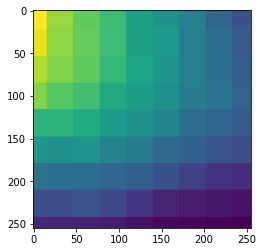

In [87]:
im_v = nl.__getattribute__('float_list').value
im_v = np.array(im_v)
im_v = np.reshape(im_v, (255, 255))
plt.imshow(im_v)


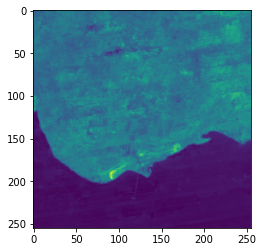

In [88]:
im_v = nir.__getattribute__('float_list').value
im_v = np.array(im_v)
im_v = np.reshape(im_v, (255, 255))
plt.imshow(im_v)

## Verify the Individual TFRecord Files (Optional)

Check that the label, location, and year values in each individual TFRecord file match the original CSV.

In [10]:
def validate_individual_tfrecords(tfrecord_paths: Iterable[str],
                                  csv_path: str,
                                  label_name: Optional[str] = None) -> None:
    '''
    Args
    - tfrecord_paths: list of str, paths to individual TFRecord files
        in the same order as in the CSV
    - csv_path: str, path to CSV file with columns ['lat', 'lon', 'wealthpooled', 'year']
    '''
    df = pd.read_csv(csv_path, float_precision='high', index_col=False)
    iter_init, batch_op = batcher.Batcher(
        tfrecord_files=tfrecord_paths,
        label_name=label_name,
        ls_bands=None,
        nl_band=None,
        batch_size=128,
        shuffle=False,
        augment=False,
        clipneg=False,
        normalize=None).get_batch()
    #pdb.set_trace()
    locs, years = [], []
    if label_name is not None:
        labels = []
    #pdb.set_trace()
    num_processed = 0
    with tf.Session() as sess:
        sess.run(iter_init)
        while True:
            try:
                if label_name is not None:
                    batch_np = sess.run((batch_op['locs'], batch_op['years'], batch_op['labels']))
                    labels.append(batch_np[2])
                else:
                    batch_np = sess.run((batch_op['locs'], batch_op['years']))
                locs.append(batch_np[0])
                years.append(batch_np[1])
                num_processed += len(batch_np[0])
                print(f'\rProcessed {num_processed} images', end='')
            except tf.errors.OutOfRangeError:
                break
    print()

    locs = np.concatenate(locs)
    years = np.concatenate(years)
    #pdb.set_trace()
    assert (locs == df[['lat', 'lon']].to_numpy(dtype=np.float32)).all()
    assert (years == df['year'].to_numpy(dtype=np.float32)).all()
    if label_name is not None:
        labels = np.concatenate(labels)
        assert (labels == df['wealthpooled'].to_numpy(dtype=np.float32)).all()

In [ ]:
validate_individual_tfrecords(
    tfrecord_paths=tfrecord_paths_utils.dhs(),
    csv_path='data/dhs_clusters.csv',
    label_name='wealthpooled')

2023-03-02 00:05:56.814546: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: AVX2 AVX512F FMA
2023-03-02 00:05:57.209197: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2800280000 Hz
2023-03-02 00:05:57.210263: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x5613db293790 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2023-03-02 00:05:57.210295: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version


Processed 10880 images

In [ ]:
validate_individual_tfrecords(
    tfrecord_paths=tfrecord_paths_utils.dhsnl(),
    csv_path='data/dhsnl_locs.csv')

In [ ]:
validate_individual_tfrecords(
    tfrecord_paths=tfrecord_paths_utils.lsms(),
    csv_path='data/lsms_clusters.csv')

## Calculate Mean and Std-Dev for Each Band

The means and standard deviations calculated here are saved as constants in `batchers/dataset_constants.py` for `_MEANS_DHS`, `_STD_DEVS_DHS`, `_MEANS_LSMS`, and `_STD_DEVS_LSMS`.

In [14]:
def calculate_mean_std(tfrecord_paths):
    '''Calculates and prints the per-band means and std-devs'''
    iter_init, batch_op = batcher.Batcher(
        tfrecord_files=tfrecord_paths,
        label_name=None,
        ls_bands='ms',
        nl_band='merge',
        batch_size=128,
        shuffle=False,
        augment=False,
        clipneg=False,
        normalize=None).get_batch()

    stats = analyze_tfrecord_batch(
        iter_init, batch_op, total_num_images=len(tfrecord_paths),
        nbands=len(BANDS_ORDER), k=10)
    means, stds = per_band_mean_std(stats=stats, band_order=BANDS_ORDER)

    print('Means:')
    pprint(means)
    print()

    print('Std Devs:')
    pprint(stds)

    print('\n========== Additional Per-band Statistics ==========\n')
    print_analysis_results(stats, BANDS_ORDER)

In [15]:
calculate_mean_std(tfrecord_paths_utils.dhs())

Instructions for updating:
Use `for ... in dataset:` to iterate over a dataset. If using `tf.estimator`, return the `Dataset` object directly from your input function. As a last resort, you can use `tf.compat.v1.data.make_initializable_iterator(dataset)`.



2023-03-02 00:52:54.551988: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: AVX2 AVX512F FMA
2023-03-02 00:52:54.557013: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2800280000 Hz
2023-03-02 00:52:54.558074: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x55eafa01fe70 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2023-03-02 00:52:54.558101: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version


Finished. Processed 19669 images.
Time per batch - mean: 19.795s, std: 3.341s
Time to process each batch - mean: 2.144s, std: 0.066s
Total time: 3378.991s, Num batches: 154
Means:
{'BLUE': 0.05919213694218452,
 'DMSP': 4.005495987761975,
 'GREEN': 0.0886244088218731,
 'NIR': 0.25306049302693995,
 'RED': 0.10415100606497593,
 'SWIR1': 0.2468749850411936,
 'SWIR2': 0.16872964353598596,
 'TEMP1': 299.07871868597624,
 'VIIRS': 1.0960891953734837}

Std Devs:
{'BLUE': 0.022926104077448887,
 'DMSP': 23.038301356943784,
 'GREEN': 0.03188622209694055,
 'NIR': 0.05896296338469802,
 'RED': 0.05146540217297948,
 'SWIR1': 0.08886411961146953,
 'SWIR2': 0.08325203890095118,
 'TEMP1': 4.301408065948617,
 'VIIRS': 4.786353810185066}

========== Additional Per-band Statistics ==========

Statistics including bad pixels
Band BLUE     - mean:   0.059192, std:  0.022926, min:     -0.1126, max:    2.000000
Band GREEN    - mean:   0.088624, std:  0.031887, min:     -0.0001, max:    2.000000
Band RED      - 

In [ ]:
calculate_mean_std(tfrecord_paths_utils.dhsnl())

In [ ]:
calculate_mean_std(tfrecord_paths_utils.lsms())